## scGen batch correction and analysis of Mural Cells
By Monika Litvinukova <br/>
Latest update 23.07.20

### Import required modules

In [1]:
import scgen
import anndata
import numpy as np
import scanpy as sc
import pandas as pd
import tensorflow as tf

Using TensorFlow backend.
/opt/conda/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/opt/conda/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/opt/conda/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/opt/conda/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [2]:
sc.settings.verbosity = 3
sc.logging.print_version_and_date()
sc.settings.set_figure_params(dpi = 260, color_map = 'RdPu', dpi_save = 260, vector_friendly = True, format = 'svg')

Running Scanpy 1.4.4.post1, on 2020-05-05 13:19.


### Fixed function to correct batches.

- This was modified for `scGen` not to jumble the `adata` index and to keep `adata.raw`.
- Once `scGen` updates this in the new version, we can skip it.

In [3]:
import os
from random import shuffle

import anndata
import numpy as np
import scanpy as sc
from matplotlib import pyplot as plt
from scipy import sparse
from sklearn import preprocessing
import pandas as pd

import scgen


def batch_removal_ct5(network, adata, batch_key="batch", cell_label_key="cell_type"):
    """
        Removes batch effect of adata
        # Parameters
        network: `scgen VAE`
            Variational Auto-encoder class object after training the network.
        adata: `~anndata.AnnData`
            Annotated data matrix. adata must have `batch_key` and `cell_label_key` which you pass to the function
             in its obs.
        # Returns
            corrected: `~anndata.AnnData`
                Annotated matrix of corrected data consisting of all cell types whether they have batch effect or not.
        # Example
        ```python
        import scgen
        import anndata
        train = anndata.read("data/pancreas.h5ad")
        train.obs["cell_type"] = train.obs["celltype"].tolist()
        network = scgen.VAEArith(x_dimension=train.shape[1], model_path="./models/batch")
        network.train(train_data=train, n_epochs=20)
        corrected_adata = scgen.batch_removal(network, train)
        ```
     """
    if sparse.issparse(adata.X):
        latent_all = network.to_latent(adata.X.A)
    else:
        latent_all = network.to_latent(adata.X)
    adata_latent = anndata.AnnData(latent_all)
    adata_latent.obs = adata.obs.copy(deep=True)
    unique_cell_types = np.unique(adata_latent.obs[cell_label_key])
    shared_ct = []
    not_shared_ct = []
    for cell_type in unique_cell_types:
        temp_cell = adata_latent[adata_latent.obs[cell_label_key] == cell_type]
        if len(np.unique(temp_cell.obs[batch_key])) < 2:
            cell_type_ann = adata_latent[adata_latent.obs[cell_label_key] == cell_type]
            not_shared_ct.append(cell_type_ann)
            continue
        temp_cell = adata_latent[adata_latent.obs[cell_label_key] == cell_type]
        batch_list = {}
        batch_ind = {}
        max_batch = 0
        max_batch_ind = ""
        batches = np.unique(temp_cell.obs[batch_key])
        for i in batches:
            temp = temp_cell[temp_cell.obs[batch_key] == i]
            temp_ind = temp_cell.obs[batch_key] == i
            if max_batch < len(temp):
                max_batch = len(temp)
                max_batch_ind = i
            batch_list[i] = temp
            batch_ind[i] = temp_ind
        max_batch_ann = batch_list[max_batch_ind]
        for study in batch_list:
            delta = np.average(max_batch_ann.X, axis=0) - np.average(batch_list[study].X, axis=0)
            batch_list[study].X = delta + batch_list[study].X
            temp_cell[batch_ind[study]].X = batch_list[study].X
        shared_ct.append(temp_cell)
    all_shared_ann = anndata.AnnData.concatenate(*shared_ct, batch_key="concat_batch", index_unique=None)
    if "concat_batch" in all_shared_ann.obs.columns:
        del all_shared_ann.obs["concat_batch"]
    if len(not_shared_ct) < 1:
        corrected = anndata.AnnData(network.reconstruct(all_shared_ann.X, use_data=True))
        corrected.obs = all_shared_ann.obs.copy(deep=True)
        corrected.var_names = adata.var_names.tolist()
        corrected = corrected[adata.obs_names]
        if adata.raw is not None:
            adata_raw = anndata.AnnData(X=adata.raw.X, var=adata.raw.var)
            adata_raw.obs_names = adata.obs_names
            corrected.raw = adata_raw
        return corrected
    else:
        all_not_shared_ann = anndata.AnnData.concatenate(*not_shared_ct, batch_key="concat_batch", index_unique=None)
        all_corrected_data = anndata.AnnData.concatenate(all_shared_ann, all_not_shared_ann, batch_key="concat_batch",  index_unique=None)
        if "concat_batch" in all_shared_ann.obs.columns:
            del all_corrected_data.obs["concat_batch"]
        corrected = anndata.AnnData(network.reconstruct(all_corrected_data.X, use_data=True), )
        corrected.obs = pd.concat([all_shared_ann.obs, all_not_shared_ann.obs])
        corrected.var_names = adata.var_names.tolist()
        corrected = corrected[adata.obs_names]
        if adata.raw is not None:
            adata_raw = anndata.AnnData(X=adata.raw.X, var=adata.raw.var)
            adata_raw.obs_names = adata.obs_names
            corrected.raw = adata_raw
        return corrected

### Read in data
the objects have raw counts in the `adata.X` and no raw

In [4]:
mc_raw = sc.read_h5ad('/home/jovyan/mona_data/5-Mural/heart_mc_merged_annotated_ml200423_RAW.h5ad')
mc_raw.shape

(94344, 33538)

In [5]:
mc_raw.obs['cell_types'].cat.categories

Index(['MC_C0_PC', 'MC_C1_SMC', 'MC_C2_stromal', 'MC_C3_PC', 'MC_C4_artSMC',
       'MC_C5_PC', 'MC_C6_PC', 'MC_D0_PC', 'MC_D1_stromal', 'MC_D2_SMC',
       'MC_D3_PC', 'MC_D4_stromal', 'MC_D5_PC', 'MC_D6_stromal', 'MC_D7_SMC',
       'MC_D8_artSMC', 'MC_H0_PC', 'MC_H1_PC', 'MC_H2_PC', 'MC_H3_SMC',
       'MC_H4_stromal', 'MC_H5_cmc', 'MC_H6_SMCart', 'MC_H7_EC-like',
       'MC_S0_PC', 'MC_S1_PC', 'MC_S2_stromal', 'MC_S3_PC', 'MC_S4_SMC',
       'MC_S5_PC', 'MC_S6_PC', 'MC_S7_PC', 'MC_S8_lnEC', 'MC_S9_cmc',
       'MC_S10_fb'],
      dtype='object')

In [6]:
trans_from = [['MC_C0_PC','MC_C3_PC','MC_C5_PC', 'MC_D0_PC','MC_D3_PC','MC_D5_PC','MC_H0_PC','MC_H1_PC','MC_S0_PC', 'MC_S1_PC','MC_S6_PC','MC_S7_PC','MC_C6_PC','MC_S3_PC','MC_S5_PC','MC_H2_PC'],
              ['MC_C1_SMC','MC_D2_SMC','MC_D7_SMC','MC_H3_SMC','MC_S4_SMC'],
              ['MC_C4_artSMC','MC_D8_artSMC','MC_H6_SMCart',],
              ['MC_C2_stromal', 'MC_D1_stromal', 'MC_D4_stromal', 'MC_D6_stromal', 'MC_H4_stromal','MC_H7_EC-like', 'MC_S2_stromal','MC_S8_lnEC'],
              ['MC_H5_cmc','MC_S9_cmc'],
              ['MC_S10_fb']]

trans_to = ['PC_basic', 'SMC_basic', 'SMC_art', 'PC-EC_Stromal','CMC_like_MC', 'FB_like_MC']

mc_raw.obs['cell_type'] = [str(i) for i in mc_raw.obs['cell_types']]
for leiden,celltype in zip(trans_from, trans_to):
    for leiden_from in leiden:
        mc_raw.obs['cell_type'][mc_raw.obs['cell_type'] == leiden_from] = celltype
mc_raw.shape

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]


(94344, 33538)

In [7]:
mc_raw.obs['cell_type'] = mc_raw.obs['cell_type'].astype('category')
mc_raw.obs['cell_type'].cat.categories

Index(['CMC_like_MC', 'FB_like_MC', 'PC-EC_Stromal', 'PC_basic', 'SMC_art',
       'SMC_basic'],
      dtype='object')

### Normalise the dataset

In [10]:
mc = mc_raw.copy()
sc.pp.normalize_per_cell(mc)
sc.pp.log1p(mc)
mc.raw = mc.copy()

normalizing by total count per cell
    finished (0:00:02): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


### Identify HVG

In [11]:
sc.pp.highly_variable_genes(mc, n_top_genes = 7000)
mc_hvg = mc[:, mc.var['highly_variable']]
mc_hvg.shape

extracting highly variable genes
    finished (0:00:15)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


(94344, 7000)

### Run scGEN on source

- Prepare the object

In [12]:
hvg_scGen_batch_1 = mc_hvg.copy()
hvg_scGen_batch_1.obs["batch"] = mc_hvg.obs["cell_source"].tolist()
hvg_scGen_batch_1.obs["cell_type"] = mc_hvg.obs["cell_type"].tolist()

- Prepare scGEN object

In [13]:
tf.reset_default_graph()
network_batch_1 = scgen.VAEArith(x_dimension = hvg_scGen_batch_1.shape[1], model_path = "/home/jovyan/mona_data/5-Mural/models")


The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.



Instructions for updating:
Use keras.layers.dense instead.
Instructions for updating:
Use keras.layers.BatchNormalization instead.  In particular, `tf.control_dependencies(tf.GraphKeys.UPDATE_OPS)` should not be used (consult the `tf.keras.layers.batch_normalization` documentation).
Instructions for updating:
Use keras.layers.dropout instead.






- Train the model

In [14]:
network_batch_1.train(train_data = hvg_scGen_batch_1, n_epochs = 20)

- Correct batches

In [15]:
corrected_batch_1 = batch_removal_ct5(network_batch_1, hvg_scGen_batch_1)

- Visualise

computing neighbors
         Falling back to preprocessing with `sc.pp.pca` and default params.
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:23)


/opt/conda/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../opt/conda/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  self.func_ir.loc))
/opt/conda/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../opt/conda/lib/python3.7/site-packages/umap/utils.py", line 409:
@numba.njit(parall

    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:01:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:53)


... storing 'age_group' as categorical
... storing 'batch' as categorical
... storing 'cell_source' as categorical
... storing 'cell_type' as categorical
... storing 'cell_types' as categorical
... storing 'donor' as categorical
... storing 'leiden' as categorical
... storing 'leiden_annotated' as categorical
... storing 'merged_source' as categorical
... storing 'sample' as categorical
... storing 'source' as categorical
/opt/conda/lib/python3.7/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


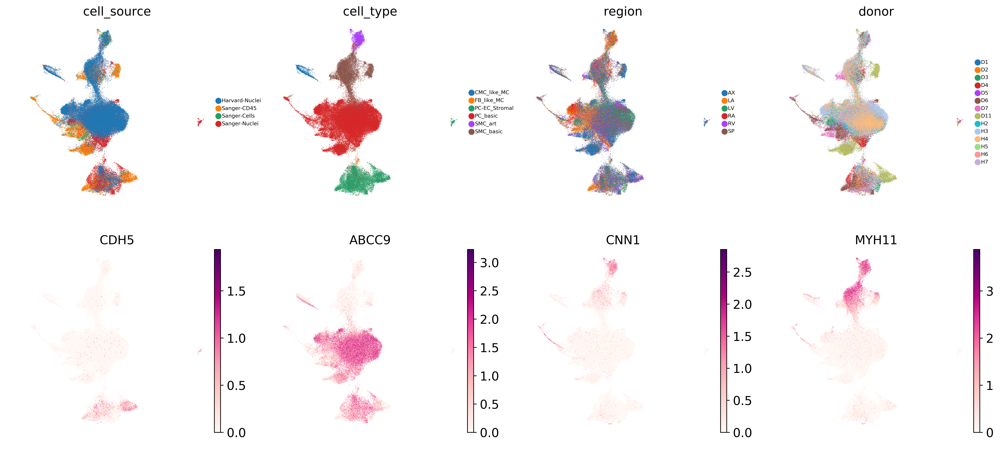

In [16]:
sc.pp.neighbors(corrected_batch_1, random_state = 1786)
sc.tl.umap(corrected_batch_1, min_dist = 0.3, spread = 1, random_state = 1786)
sc.pl.umap(corrected_batch_1, color = ['cell_source',  'cell_type', 'region', 'donor', 'CDH5', 'ABCC9', 'CNN1', 'MYH11'], size = 1, legend_fontsize = 6, color_map = 'RdPu', frameon = False)

### Correct for donor

In [17]:
hvg_scGen_batch_2 = corrected_batch_1.copy()
hvg_scGen_batch_2.obs["batch"] = corrected_batch_1.obs["donor"].tolist()
hvg_scGen_batch_2.obs["cell_type"] = corrected_batch_1.obs["cell_type"].tolist()

In [18]:
tf.reset_default_graph()
network_batch_2 = scgen.VAEArith(x_dimension = hvg_scGen_batch_2.shape[1], model_path = "/home/jovyan/mona_data/5-Mural/models")

In [19]:
network_batch_2.train(train_data = hvg_scGen_batch_2, n_epochs = 20)

In [20]:
corrected_batch_2 = batch_removal_ct5(network_batch_2, hvg_scGen_batch_2)

computing neighbors
         Falling back to preprocessing with `sc.pp.pca` and default params.
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:24)


/opt/conda/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../opt/conda/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:01:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:56)


... storing 'age_group' as categorical
... storing 'batch' as categorical
... storing 'cell_source' as categorical
... storing 'cell_type' as categorical
... storing 'cell_types' as categorical
... storing 'donor' as categorical
... storing 'leiden' as categorical
... storing 'leiden_annotated' as categorical
... storing 'merged_source' as categorical
... storing 'sample' as categorical
... storing 'source' as categorical


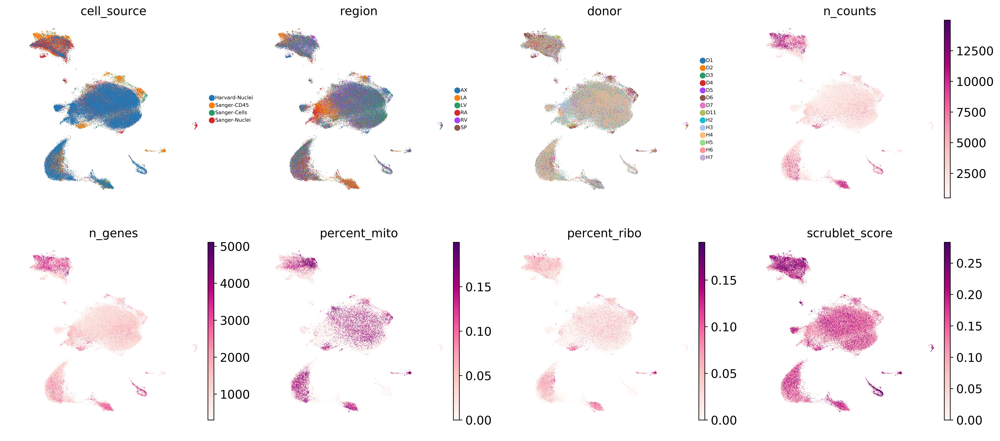

In [21]:
sc.pp.neighbors(corrected_batch_2, random_state = 1712)
sc.tl.umap(corrected_batch_2, min_dist = 0.1, spread = 3, random_state = 1712)
sc.pl.umap(corrected_batch_2, color = ['cell_source', 'region', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'scrublet_score'], size = 1, legend_fontsize = 6, color_map = 'RdPu', frameon = False)

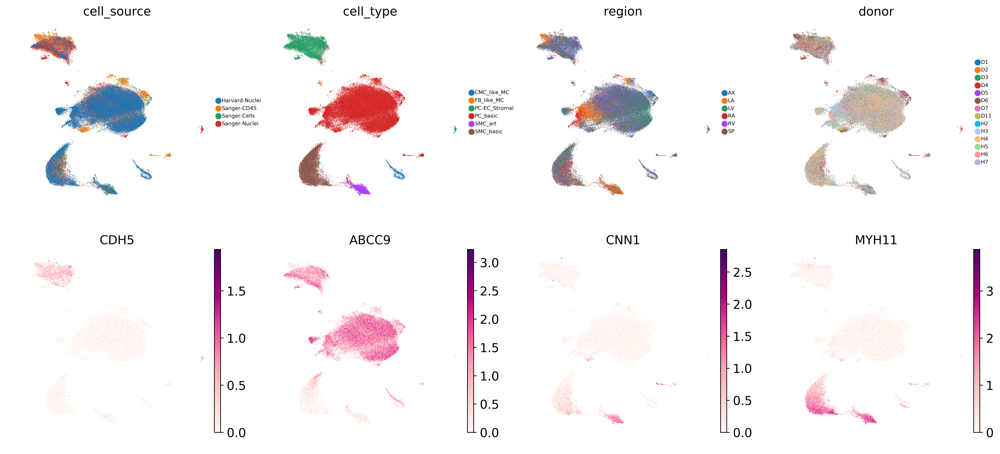

In [22]:
sc.pl.umap(corrected_batch_2, color = ['cell_source',  'cell_type', 'region', 'donor', 'CDH5', 'ABCC9', 'CNN1', 'MYH11'], size = 1, legend_fontsize = 6, color_map = 'RdPu', frameon = False)

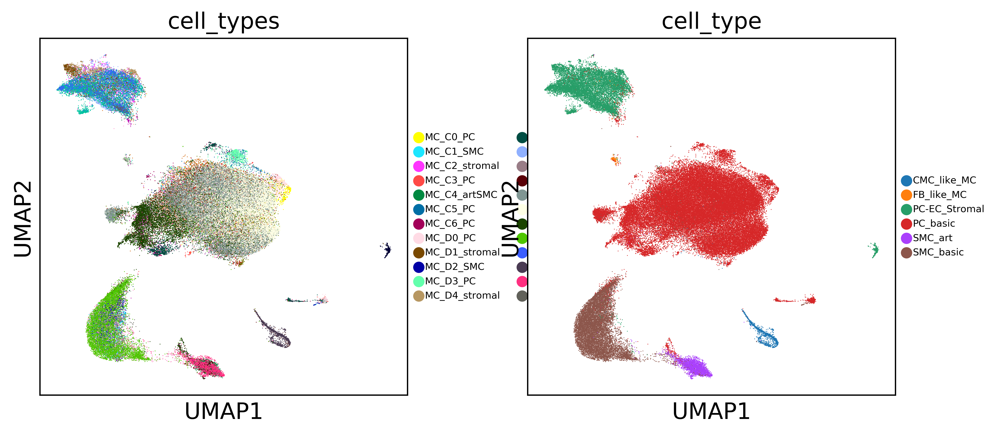

In [23]:
sc.pl.umap(corrected_batch_2, color = ['cell_types', 'cell_type'], size = 1, legend_fontsize = 6, color_map = 'RdPu')

running Leiden clustering
    finished: found 7 clusters and added
    'leiden03', the cluster labels (adata.obs, categorical) (0:01:19)
running Leiden clustering
    finished: found 7 clusters and added
    'leiden04', the cluster labels (adata.obs, categorical) (0:00:45)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden05', the cluster labels (adata.obs, categorical) (0:01:18)
running Leiden clustering
    finished: found 10 clusters and added
    'leiden06', the cluster labels (adata.obs, categorical) (0:00:49)
running Leiden clustering
    finished: found 12 clusters and added
    'leiden07', the cluster labels (adata.obs, categorical) (0:01:13)
running Leiden clustering
    finished: found 14 clusters and added
    'leiden08', the cluster labels (adata.obs, categorical) (0:03:04)
running Leiden clustering
    finished: found 15 clusters and added
    'leiden1', the cluster labels (adata.obs, categorical) (0:02:57)


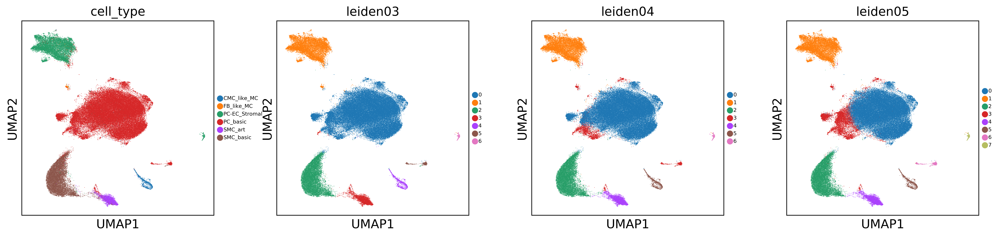

In [24]:
sc.tl.leiden(corrected_batch_2, resolution = 0.3, random_state = 1712, key_added = 'leiden03')
sc.tl.leiden(corrected_batch_2, resolution = 0.4, random_state = 1712, key_added = 'leiden04')
sc.tl.leiden(corrected_batch_2, resolution = 0.5, random_state = 1712, key_added = 'leiden05')
sc.tl.leiden(corrected_batch_2, resolution = 0.6, random_state = 1712, key_added = 'leiden06')
sc.tl.leiden(corrected_batch_2, resolution = 0.7, random_state = 1712, key_added = 'leiden07')
sc.tl.leiden(corrected_batch_2, resolution = 0.8, random_state = 1712, key_added = 'leiden08')
sc.tl.leiden(corrected_batch_2, resolution = 1, random_state = 1712, key_added = 'leiden1')

sc.pl.umap(corrected_batch_2, color = ['cell_type', 'leiden03','leiden04','leiden05'], size = 1, legend_fontsize = 6, color_map = 'RdPu')

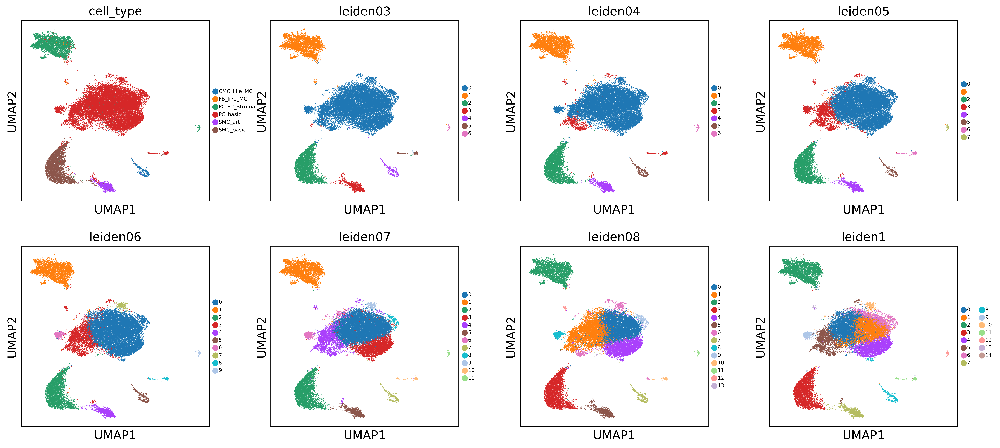

In [25]:
sc.pl.umap(corrected_batch_2, color = ['cell_type', 'leiden03','leiden04','leiden05', 'leiden06', 'leiden07', 'leiden08', 'leiden1'], size = 1, legend_fontsize = 6, color_map = 'RdPu')

### Call markers on Leiden

In [27]:
sc.tl.rank_genes_groups(corrected_batch_2, 'leiden06', method = 'wilcoxon', n_genes = 500, use_raw = True)
result = corrected_batch_2.uns['rank_genes_groups']
groups = result['names'].dtype.names
heart_scGen_wilcox = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj', 'logfoldchanges']})
heart_scGen_wilcox.head(10)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:04:19)


,0_n,0_p,0_l,1_n,1_p,1_l,2_n,2_p,2_l,3_n,...,6_l,7_n,7_p,7_l,8_n,8_p,8_l,9_n,9_p,9_l
0,DLC1,0.0,1.578392,ACTB,0.0,2.132375,MYH11,0.0,3.827353,IMMP2L,...,1.020678,JUN,0.000000e+00,5.298473,RPL41,0.0,3.578916,CCL21,9.611519e-187,9.191102
1,PDZD2,0.0,1.686404,B2M,0.0,2.781821,ZFHX3,0.0,2.144179,NLGN1,...,0.770636,JUNB,0.000000e+00,4.665267,TMSB4X,0.0,3.985827,PPFIBP1,1.841000e-181,4.275022
2,FRMD3,0.0,1.466096,IFITM3,0.0,2.288233,CASQ2,0.0,3.081836,ASAP1,...,0.805576,FOS,0.000000e+00,4.993331,FTH1,0.0,3.549719,PKHD1L1,3.880202e-140,10.085901
3,EGFLAM,0.0,1.478441,HLA-B,0.0,2.783818,PTP4A3,0.0,2.199031,STEAP4,...,0.465532,ZFP36,0.000000e+00,3.735038,RPLP1,0.0,3.410394,MAGI1,1.839399e-138,3.864680
4,CD36,0.0,1.079967,HLA-C,0.0,2.479358,RGS6,0.0,3.149541,SGIP1,...,0.606703,UBB,0.000000e+00,3.294789,RPS27,0.0,3.589230,MMRN1,7.540490e-136,11.203909
5,PDE1C,0.0,1.426638,FABP4,0.0,2.250232,TPM2,0.0,1.805788,PLPP1,...,0.519269,H3F3B,0.000000e+00,2.785102,RPL21,0.0,3.505517,ST6GALNAC3,2.335637e-134,6.927574
6,ABCC9,0.0,1.316287,CST3,0.0,1.870430,ACTA2,0.0,1.346232,RBMS3-AS2,...,0.587008,SOCS3,0.000000e+00,4.108111,RPL10,0.0,3.085979,LDB2,1.906121e-128,4.336088
7,MALAT1,0.0,0.637623,FABP5,0.0,2.799574,DSTN,0.0,1.674493,UGGT2,...,0.539910,HSPA1A,0.000000e+00,4.097210,RPL34,0.0,3.513136,EFNA5,1.139746e-114,5.748819
8,GUCY1A2,0.0,1.415357,TMSB4X,0.0,2.305160,SLIT3,0.0,2.644653,RBMS3-AS3,...,0.569236,FOSB,0.000000e+00,4.667183,RPL13A,0.0,3.311646,TSHZ2,1.074922e-106,5.898437
9,PDGFRB,0.0,0.917855,TMSB10,0.0,3.386278,NTRK3,0.0,3.926373,ARHGAP15,...,0.601502,AGT,6.585982e-305,2.953488,RPL3,0.0,3.366394,STOX2,1.122165e-103,5.473762


In [28]:
heart_scGen_wilcox.to_csv('/home/jovyan/mona_data/5-Mural/heart_mural_scGEN_ml200505_wilcox06.csv', index = False, sep = ',')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden06']`


/opt/conda/lib/python3.7/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


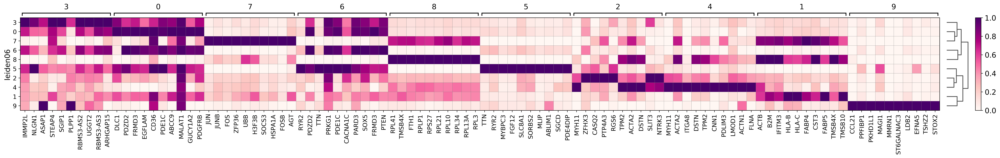

In [30]:
sc.pl.rank_genes_groups_matrixplot(corrected_batch_2, n_genes = 10, cmap = 'RdPu', standard_scale = 'var')

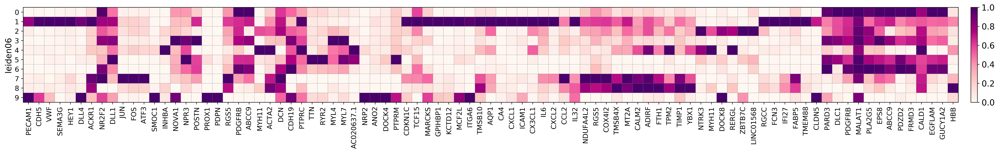

GridSpec(2, 3, height_ratios=[0, 10.5], width_ratios=[28.48, 0, 0.2])

In [33]:
ec_markers = ['PECAM1', 'CDH5', 'VWF', 'SEMA3G', 'HEY1', 'DLL4', 'ACKR1', 'NR2F2', 'DLL1', 'JUN', 'FOS', 'ATF3', 'SMOC1', 'INHBA', 
             'NOVA1', 'NPR3', 'POSTN', 'PROX1', 'PDPN', 'RGS5', 'PDGFRB', 'ABCC9', 'MYH11', 'ACTA2', 'DCN', 'CDH19', 'PTPRC', 'TTN', 'RYR2', 'MYL4', 'MYL7', 'AC020637.1',
              'NRP2','ANO2','DOCK4','PTPRM','CDKN1C','TCF15','MARCKS','GPIHBP1','KCTD12','MCF2L','ITGA6','TMSB10','AQP1','CA4', 'CXCL1','ICAM1','CX3CL1','IL6','CXCL2','CCL2','IL32',
             'NDUFA4L2','RGS5','COX4I2','TMSB4X','MT2A','CALM2','ADIRF','FTH1','TPM2','TIMP1','YBX1','NTRK3','MYH11', 'DOCK8', 'RERGL','ZBTB7C','LINC01568',
             'RGCC','FCN3','IFI27','FABP5','TMEM88','CLDN5','PARD3', 'DLC1','PDGFRB','MALAT1','PLA2G5','EPS8','ABCC9','PDZD2','FRMD3','CALD1','EGFLAM','GUCY1A2', 'HBB']
sc.pl.matrixplot(corrected_batch_2, ec_markers, groupby = 'leiden06', cmap = 'RdPu', dendrogram = False, standard_scale = 'var')

### Annotate the dataset

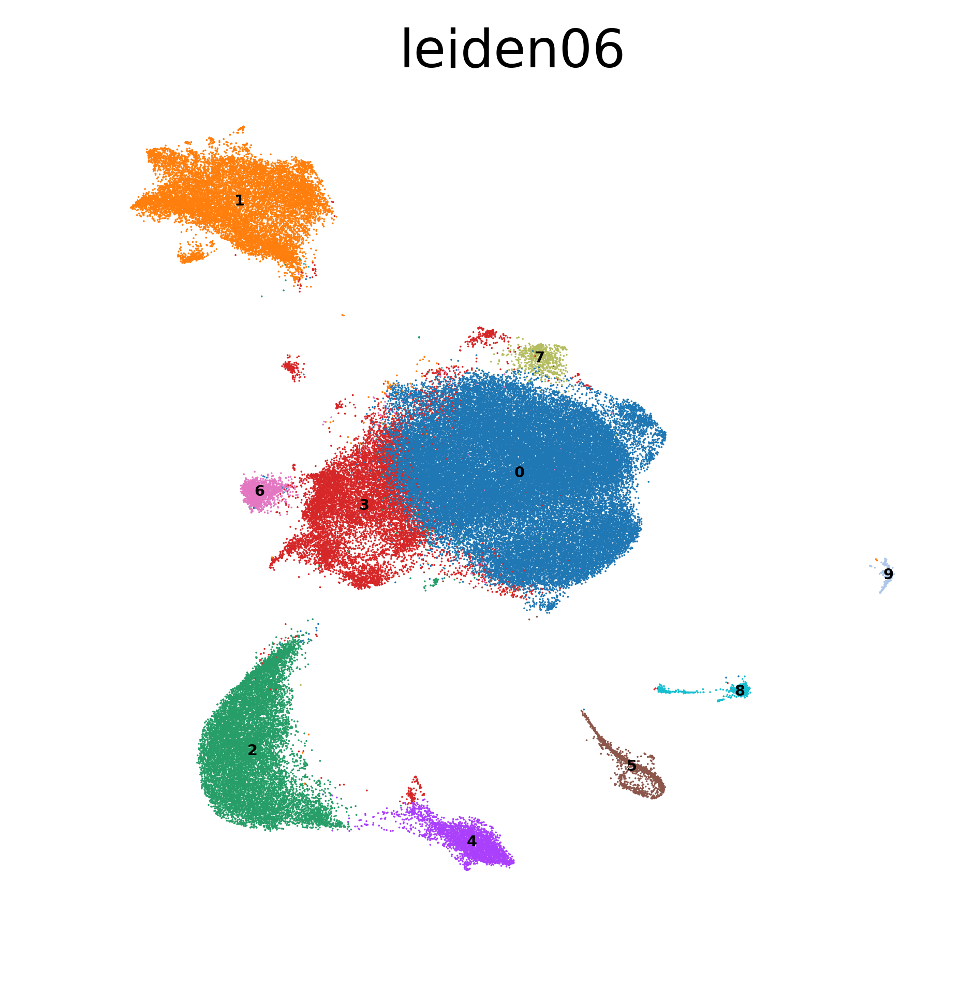

In [34]:
sc.pl.umap(corrected_batch_2, color = ['leiden06'], size = 1, legend_fontsize = 4, legend_loc = 'on data', frameon = False)

In [35]:
corrected_batch_2.obs['leiden06'].cat.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9'], dtype='object')

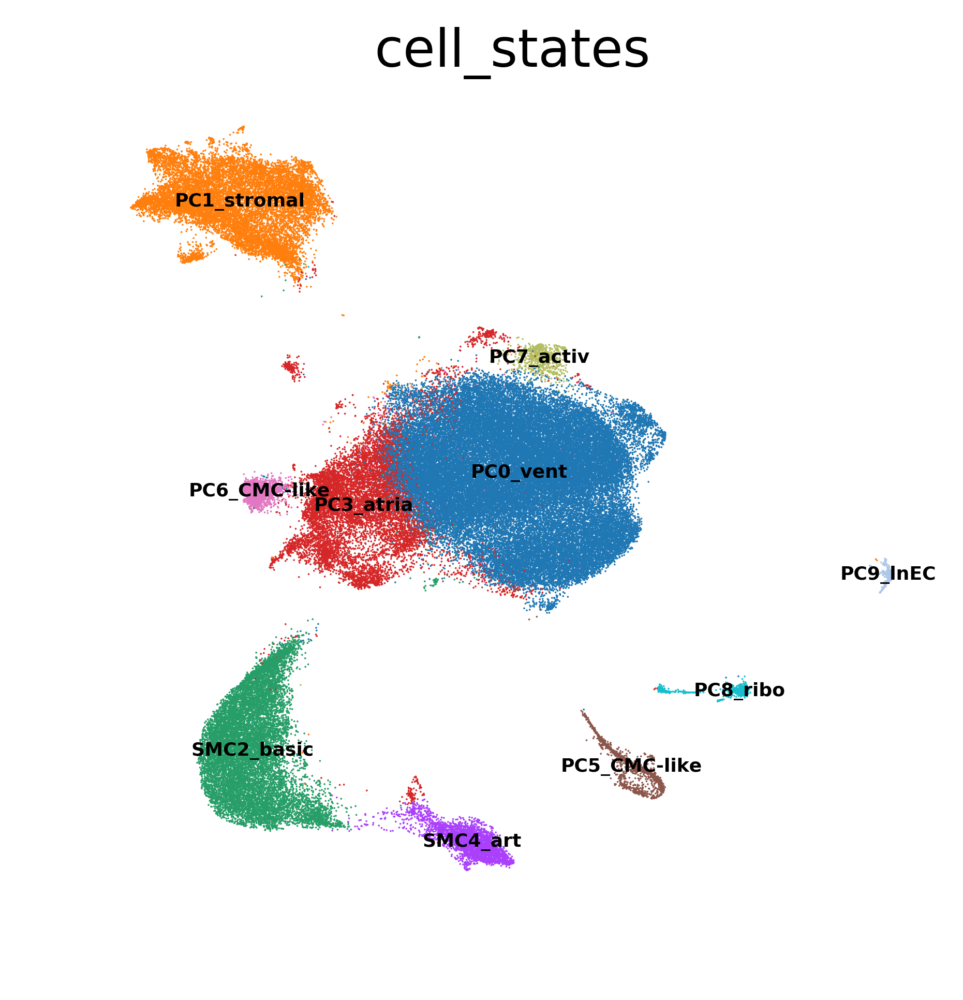

In [36]:
corrected_batch_2.obs['cell_states'] = corrected_batch_2.obs['leiden06']
corrected_batch_2.obs['cell_states'].cat.categories = ['PC0_vent', 'PC1_stromal', 'SMC2_basic', 'PC3_atria', 'SMC4_art', 'PC5_CMC-like', 
                                                       'PC6_CMC-like', 'PC7_activ', 'PC8_ribo', 'PC9_lnEC']
sc.pl.umap(corrected_batch_2, color = ['cell_states'], size = 1, legend_fontsize = 5, legend_loc = 'on data', frameon = False)

### Save and export the object

In [37]:
## Create a new object with main matrix containing all the genes, log-transformed
scGEN_website = anndata.AnnData(X = mc.X, obs = corrected_batch_2.obs , var = mc.var, obsm = corrected_batch_2.obsm)
scGEN_website

AnnData object with n_obs × n_vars = 94344 × 33538 
    obs: 'NRP', 'age_group', 'batch', 'cell_source', 'cell_type', 'cell_types', 'donor', 'gender', 'leiden', 'leiden_annotated', 'merged_source', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'source', 'type', 'version', 'leiden03', 'leiden04', 'leiden05', 'leiden06', 'leiden07', 'leiden08', 'leiden1', 'cell_states'
    var: 'gene_ids-Harvard-Nuclei-Cells', 'feature_types-Harvard-Nuclei-Cells', 'gene_ids-Sanger-Nuclei-Cells', 'feature_types-Sanger-Nuclei-Cells', 'gene_ids-Sanger-Cells-Cells', 'feature_types-Sanger-Cells-Cells', 'gene_ids-Sanger-CD45-Cells', 'feature_types-Sanger-CD45-Cells', 'gene_ids-Harvard-Nuclei-CD45', 'feature_types-Harvard-Nuclei-CD45', 'gene_ids-Sanger-Nuclei-CD45', 'feature_types-Sanger-Nuclei-CD45', 'gene_ids-Sanger-Cells-CD45', 'feature_types-Sanger-Cells-CD45', 'gene_ids-Sanger-CD45-CD45', 'feature_types-Sanger-CD45-CD45', 'gene_ids-Harvard-Nuclei-Sanger_nuclei

In [38]:
scGEN_website.write('/home/jovyan/mona_data/5-Mural/heart_Mural_scGEN_ml200511_website.h5ad')

In [39]:
## Create a new object with main matrix containing all the genes, raw
scGEN_raw = anndata.AnnData(X = mc_raw.X, obs = corrected_batch_2.obs , var = mc_raw.var, obsm = corrected_batch_2.obsm)
scGEN_raw

AnnData object with n_obs × n_vars = 94344 × 33538 
    obs: 'NRP', 'age_group', 'batch', 'cell_source', 'cell_type', 'cell_types', 'donor', 'gender', 'leiden', 'leiden_annotated', 'merged_source', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'source', 'type', 'version', 'leiden03', 'leiden04', 'leiden05', 'leiden06', 'leiden07', 'leiden08', 'leiden1', 'cell_states'
    var: 'gene_ids-Harvard-Nuclei-Cells', 'feature_types-Harvard-Nuclei-Cells', 'gene_ids-Sanger-Nuclei-Cells', 'feature_types-Sanger-Nuclei-Cells', 'gene_ids-Sanger-Cells-Cells', 'feature_types-Sanger-Cells-Cells', 'gene_ids-Sanger-CD45-Cells', 'feature_types-Sanger-CD45-Cells', 'gene_ids-Harvard-Nuclei-CD45', 'feature_types-Harvard-Nuclei-CD45', 'gene_ids-Sanger-Nuclei-CD45', 'feature_types-Sanger-Nuclei-CD45', 'gene_ids-Sanger-Cells-CD45', 'feature_types-Sanger-Cells-CD45', 'gene_ids-Sanger-CD45-CD45', 'feature_types-Sanger-CD45-CD45', 'gene_ids-Harvard-Nuclei-Sanger_nuclei

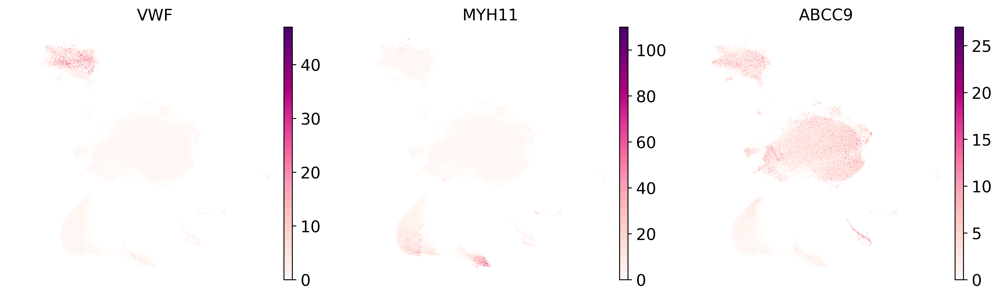

In [40]:
sc.pl.umap(scGEN_raw, color = ['VWF', 'MYH11', 'ABCC9'], size = 1, legend_fontsize = 6, color_map = 'RdPu', frameon = False)

In [41]:
scGEN_raw.write('/home/jovyan/mona_data/5-Mural/heart_Mural_scGEN_ml200511_raw.h5ad')